## **LLE_UNET Training Code**

`Colab Version`

**The notebook contains results for a sample training of 100 images and 10 epochs.**

In [34]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [35]:
%cd /content/drive/MyDrive/FYP2/Test_Models/VGG2

/content/drive/MyDrive/FYP2/Test_Models/VGG2


In [36]:
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt

import tensorflow as tf

In [37]:
# Load custom Function
import image_padding
import create_model

In [38]:
HOME = os. getcwd()
print(HOME)

/content/drive/MyDrive/FYP2/Test_Models/VGG2


In [39]:
# Avoid OOM errors by setting GPU Memory Consumption Growth
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [40]:
gpus

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [41]:
SEED = 0
np.random.seed(SEED)
tf.random.set_seed(SEED)

tf.config.run_functions_eagerly(True)

## 1- **Data Loading and Processing**

In [42]:
BATCH_SIZE = 2

train_x_dir = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/our485/low'
train_y_dir = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/our485/high'

val_x_dir = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low'
val_y_dir = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high'

test_x_dir = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low'
test_y_dir = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high'

**Create a dataloader using a custom Python function**

In [43]:
@tf.function
def load_image_file(file_path):
    file_path = file_path.numpy().decode("utf-8")
    img = cv2.imread(file_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    preprocess_img = image_padding.pad_image(img)
    preprocess_img = preprocess_img/255
    return preprocess_img

def image_dataset(directory):
    files = tf.data.Dataset.list_files(os.path.join(directory, '*.png'),shuffle=False)
    # files = files.take(20)
    dataset = files.map(lambda x: tf.py_function(load_image_file, [x], tf.float32))
    return dataset

### **Train**

In [44]:
train_x = image_dataset(train_x_dir)
train_y = image_dataset(train_y_dir)

# combine input and output
train = tf.data.Dataset.zip((train_x, train_y))
train = train.shuffle(100)
train = train.batch(BATCH_SIZE)
train.prefetch(tf.data.AUTOTUNE)

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=<unknown>, dtype=tf.float32, name=None))>

## **Val**

In [45]:
val_x = image_dataset(val_x_dir)
val_y = image_dataset(val_y_dir)

# combine input and output
val = tf.data.Dataset.zip((val_x, val_y))
# train = train.shuffle(100)
val = val.batch(BATCH_SIZE)
val.prefetch(tf.data.AUTOTUNE)

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=<unknown>, dtype=tf.float32, name=None))>

## **Test**

In [46]:
test_x = image_dataset(test_x_dir)
test_y = image_dataset(test_y_dir)

# combine input and output
test = tf.data.Dataset.zip((test_x, test_y))
# train = train.shuffle(100)
test = test.batch(BATCH_SIZE)
test.prefetch(tf.data.AUTOTUNE)

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=<unknown>, dtype=tf.float32, name=None))>

## **View Samples**

In [47]:
# data iterator
data_samples = train.as_numpy_iterator()

In [48]:
res = data_samples.next()
print(len(res))
res[0].shape

2


(2, 400, 608, 3)

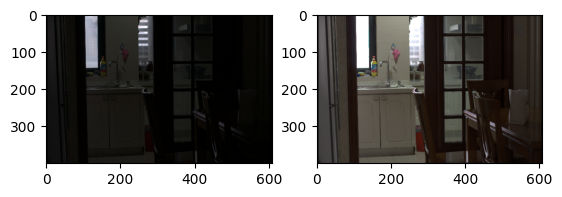

In [49]:
res_low_1 = res[0][0]
res_high_1 = res[1][0]

fig, axs = plt.subplots(ncols=2);
axs[0].imshow(res_low_1);
axs[1].imshow(res_high_1);

#2- **Model Building**

In [50]:
input_shape = (None, None, 3)
model = create_model.build_model(input_shape)
# model.summary()

In [51]:
# tf.keras.utils.plot_model(
#     model,
#     to_file="model_v2.png",
#     show_shapes=True,
#     show_layer_activations=True,
# )

In [52]:
print("trainable_weights:", len(model.trainable_weights))
print("non_trainable_weights:", len(model.non_trainable_weights))

trainable_weights: 58
non_trainable_weights: 42


## **Setup Losses and Optimizer**

In [53]:
#optimizer = tf.keras.optimizers.experimental.AdamW(learning_rate=0.0001,weight_decay=0.004)
optimizer = tf.keras.optimizers.Adam(learning_rate=3e-4)
MSEloss = tf.keras.losses.MeanSquaredError()

def charbonnier_loss(y_true, y_pred):
    return tf.reduce_mean(tf.sqrt(tf.square(y_true - y_pred) + tf.square(1e-3)))

def psnr_loss_fn(y_true, y_pred):
    return tf.image.psnr(y_pred, y_true, max_val=1.0)

def ssim_loss_fn(y_true,y_pred):
    return tf.image.ssim(y_true,y_pred,1.0)


*   callbacks to save best model

*   And Infer the Model while trainning

*   Tensorboard Callback

Save the models in `models --> folder_name_current_datatime`

The best model is saved by monitoring the validation loss.

In [54]:
from keras.callbacks import ModelCheckpoint

# tensorboard callback
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="./logs")

# save_best_model_callback
from datetime import datetime
model_save_folder = datetime.now().strftime("%Y%m%d_%H%M%S")
model_save_dir = f'models/{model_save_folder}'
#model_save_dir = f'models'

if not os.path.exists(model_save_dir):
  print("FOLDER CREATED")
  os.makedirs(model_save_dir)

save_best_model_checkpoint = ModelCheckpoint(model_save_dir+'/model-{epoch:03d}.hdf5',monitor='val_loss',save_best_only=True,mode='auto')

FOLDER CREATED


In [83]:
def preprocess_image(img_path):
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  preprocess_img = image_padding.pad_image(img)
  preprocess_img = preprocess_img/255;
  return preprocess_img

In [56]:
# test_low_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low'
# test_high_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high'

In [57]:
def find_target_img_path(test_img_file):
  test_img_filename = os.path.basename(test_img_file)
  high_img_path = os.path.join(test_y_dir,test_img_filename)
  return high_img_path

In [58]:
def infer(n_images=2):
  test_x_images = os.listdir(test_x_dir)

  for i,image_name in enumerate(test_x_images):
    if i == n_images:
      break
    image_path = os.path.join(test_x_dir,image_name)
    print(f'{i+1}/{n_images} : {image_path}')
    x_img = preprocess_image(image_path)
    prediction = model.predict(np.expand_dims(x_img,axis=0),verbose=0)

    y_img_path = find_target_img_path(image_path)
    y_img = preprocess_image(y_img_path)

    fig, ax = plt.subplots(ncols=3, figsize=(15,10));
    ax[0].imshow(x_img);
    ax[1].imshow(prediction[0]);
    ax[2].imshow(y_img);
    ax[0].axis('off');
    ax[1].axis('off');
    ax[2].axis('off');
    ax[0].set_title("Low Image")
    ax[1].set_title("Predicted Image")
    ax[2].set_title("High Image")
    plt.show()

**This callback is used to get the outputs of the intermediate trained model**

In [59]:
from tensorflow.keras import callbacks
class PredictionCallback(callbacks.Callback):
    def __init__(self, log_interval, *args, **kwargs):
        super().__init__(*args, **kwargs)
        #self.image_files = image_files
        self.log_interval = log_interval

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.log_interval == 0:
          infer(n_images=2)


In [60]:
#model.compile(optimizer,loss, metrics = [charbonnier_loss,psnr_loss_fn,ssim_loss_fn])
model.compile(optimizer,charbonnier_loss, metrics = [MSEloss,psnr_loss_fn,ssim_loss_fn])

## **Sense the predictions**

In [61]:
X, y = train.as_numpy_iterator().next()
X.shape

(2, 400, 608, 3)

1/1 [==============================] - 0s 140ms/step


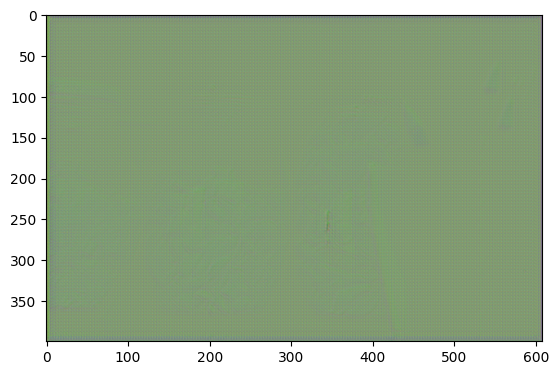

In [62]:
pred = model.predict(X)
plt.imshow(pred[0]);

## **Load Model**

In [63]:
# from keras.models import load_model
# model_path = r'/content/drive/MyDrive/FYP2/Test_Models/VGG_LowLight_v1/Test_VGG_LowLight_charbonnier_loss.h5'
# model = load_model(model_path,custom_objects={'charbonnier_loss': charbonnier_loss,
#                                               'psnr_loss_fn':psnr_loss_fn,
#                                               'ssim_loss_fn':ssim_loss_fn})

# compile = False

##**Train the Model**

In [64]:
LOG_INTERVALS = 2
EPOCHS = 10

Epoch 1/10
243/243 [==============================] - ETA: 0s - loss: 0.1223 - mean_squared_error: 0.0246 - psnr_loss_fn: 17.5610 - ssim_loss_fn: 0.63371/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


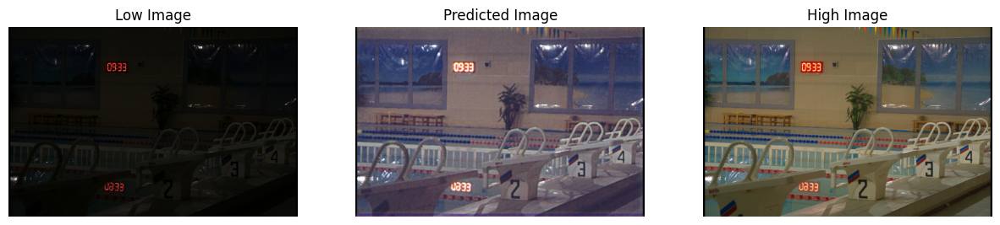

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


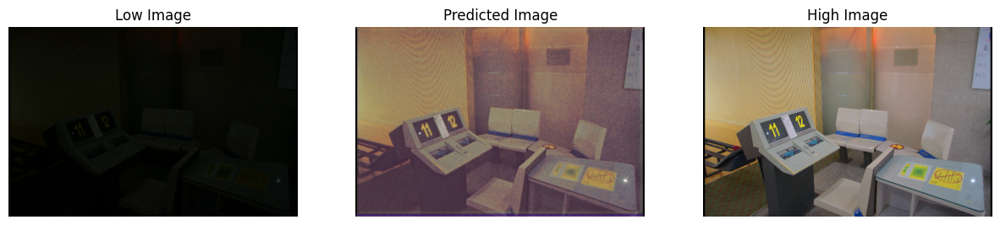

243/243 [==============================] - 214s 867ms/step - loss: 0.1223 - mean_squared_error: 0.0246 - psnr_loss_fn: 17.5610 - ssim_loss_fn: 0.6337 - val_loss: 0.1112 - val_mean_squared_error: 0.0200 - val_psnr_loss_fn: 18.4593 - val_ssim_loss_fn: 0.6984
Epoch 2/10
243/243 [==============================] - 199s 806ms/step - loss: 0.1092 - mean_squared_error: 0.0192 - psnr_loss_fn: 18.7815 - ssim_loss_fn: 0.7341 - val_loss: 0.1085 - val_mean_squared_error: 0.0186 - val_psnr_loss_fn: 18.8978 - val_ssim_loss_fn: 0.7147
Epoch 3/10
243/243 [==============================] - ETA: 0s - loss: 0.1036 - mean_squared_error: 0.0173 - psnr_loss_fn: 19.2452 - ssim_loss_fn: 0.75111/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


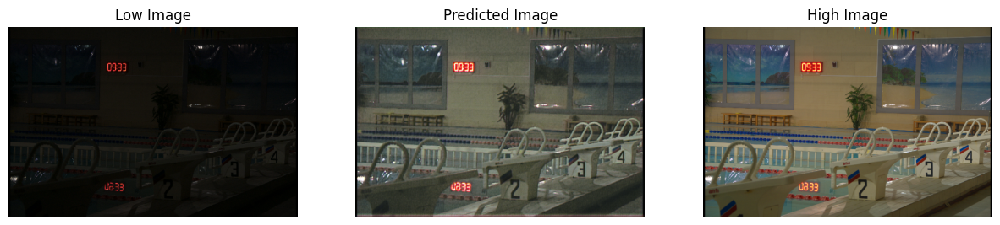

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


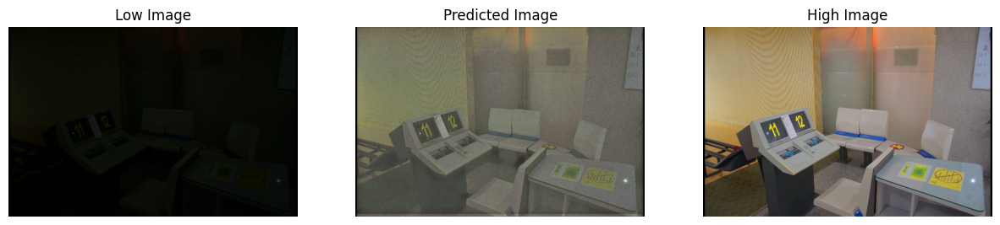

243/243 [==============================] - 199s 806ms/step - loss: 0.1036 - mean_squared_error: 0.0173 - psnr_loss_fn: 19.2452 - ssim_loss_fn: 0.7511 - val_loss: 0.1099 - val_mean_squared_error: 0.0181 - val_psnr_loss_fn: 18.2908 - val_ssim_loss_fn: 0.7161
Epoch 4/10
243/243 [==============================] - 217s 882ms/step - loss: 0.1010 - mean_squared_error: 0.0168 - psnr_loss_fn: 19.4219 - ssim_loss_fn: 0.7590 - val_loss: 0.1263 - val_mean_squared_error: 0.0240 - val_psnr_loss_fn: 17.7137 - val_ssim_loss_fn: 0.6731
Epoch 5/10
243/243 [==============================] - ETA: 0s - loss: 0.1021 - mean_squared_error: 0.0169 - psnr_loss_fn: 19.3647 - ssim_loss_fn: 0.76371/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


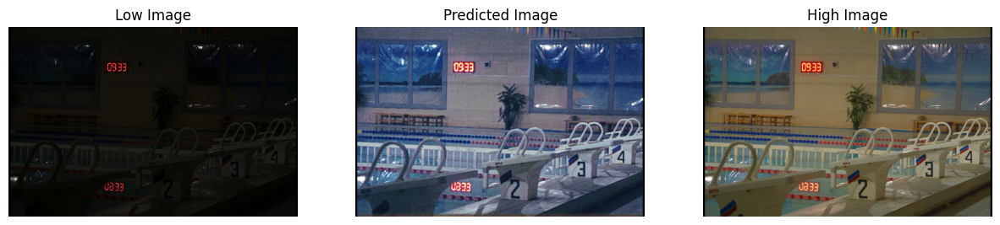

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


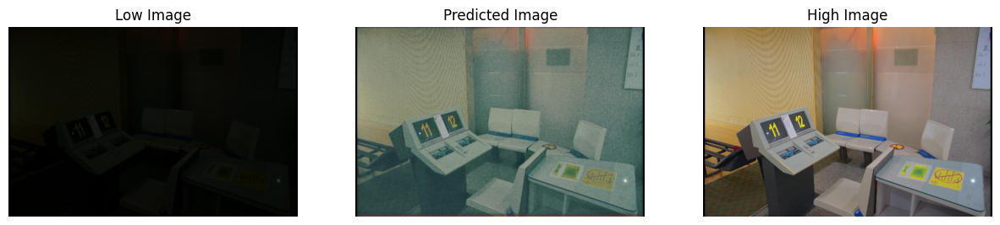

243/243 [==============================] - 195s 789ms/step - loss: 0.1021 - mean_squared_error: 0.0169 - psnr_loss_fn: 19.3647 - ssim_loss_fn: 0.7637 - val_loss: 0.1196 - val_mean_squared_error: 0.0238 - val_psnr_loss_fn: 18.0004 - val_ssim_loss_fn: 0.7161
Epoch 6/10
243/243 [==============================] - 188s 761ms/step - loss: 0.0981 - mean_squared_error: 0.0157 - psnr_loss_fn: 19.5809 - ssim_loss_fn: 0.7632 - val_loss: 0.1149 - val_mean_squared_error: 0.0191 - val_psnr_loss_fn: 18.1877 - val_ssim_loss_fn: 0.7410
Epoch 7/10
243/243 [==============================] - ETA: 0s - loss: 0.0962 - mean_squared_error: 0.0153 - psnr_loss_fn: 19.8287 - ssim_loss_fn: 0.77301/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


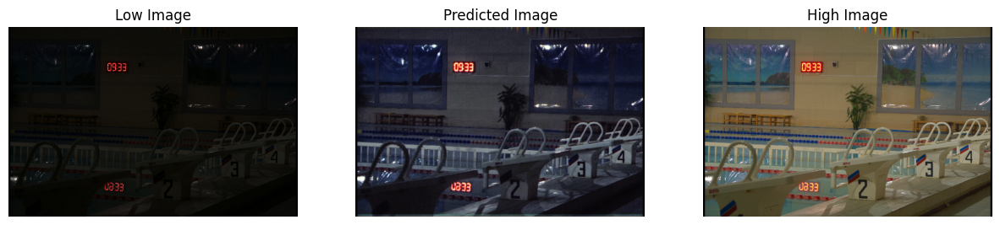

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


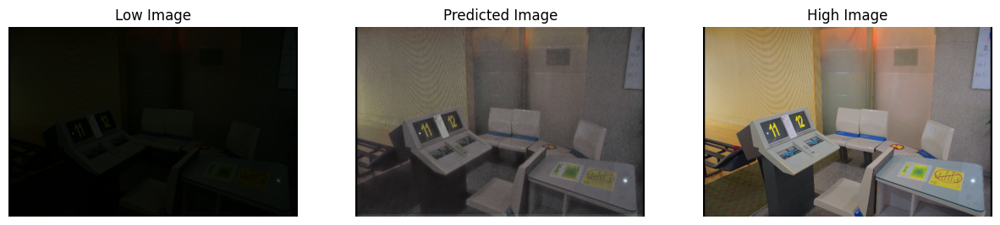

243/243 [==============================] - 204s 826ms/step - loss: 0.0962 - mean_squared_error: 0.0153 - psnr_loss_fn: 19.8287 - ssim_loss_fn: 0.7730 - val_loss: 0.1624 - val_mean_squared_error: 0.0389 - val_psnr_loss_fn: 15.7089 - val_ssim_loss_fn: 0.6851
Epoch 8/10
243/243 [==============================] - 188s 763ms/step - loss: 0.0971 - mean_squared_error: 0.0151 - psnr_loss_fn: 19.7224 - ssim_loss_fn: 0.7738 - val_loss: 0.1381 - val_mean_squared_error: 0.0280 - val_psnr_loss_fn: 16.6895 - val_ssim_loss_fn: 0.7190
Epoch 9/10
243/243 [==============================] - ETA: 0s - loss: 0.0955 - mean_squared_error: 0.0148 - psnr_loss_fn: 19.8980 - ssim_loss_fn: 0.77721/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


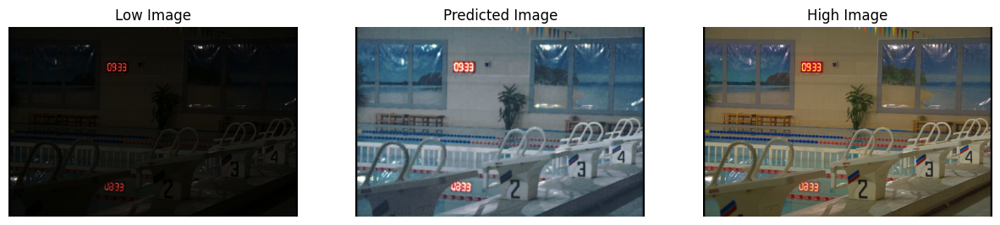

2/2 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


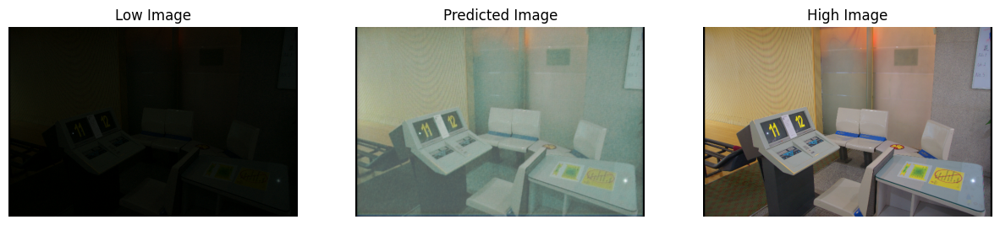

243/243 [==============================] - 190s 769ms/step - loss: 0.0955 - mean_squared_error: 0.0148 - psnr_loss_fn: 19.8980 - ssim_loss_fn: 0.7772 - val_loss: 0.1175 - val_mean_squared_error: 0.0211 - val_psnr_loss_fn: 18.0865 - val_ssim_loss_fn: 0.7378
Epoch 10/10
243/243 [==============================] - 188s 762ms/step - loss: 0.0925 - mean_squared_error: 0.0139 - psnr_loss_fn: 20.0746 - ssim_loss_fn: 0.7831 - val_loss: 0.1946 - val_mean_squared_error: 0.0612 - val_psnr_loss_fn: 14.7165 - val_ssim_loss_fn: 0.6185


In [65]:
# Train for 10 epochs

hist = model.fit(train, epochs=EPOCHS, validation_data = val, callbacks=[tensorboard_callback,save_best_model_checkpoint,
                                                                        PredictionCallback(log_interval = LOG_INTERVALS)])

In [66]:
# save weights
model.save("LLE_UNET.h5")

# save entire model
model.save('LLE_UNET')

## **Performace Check**

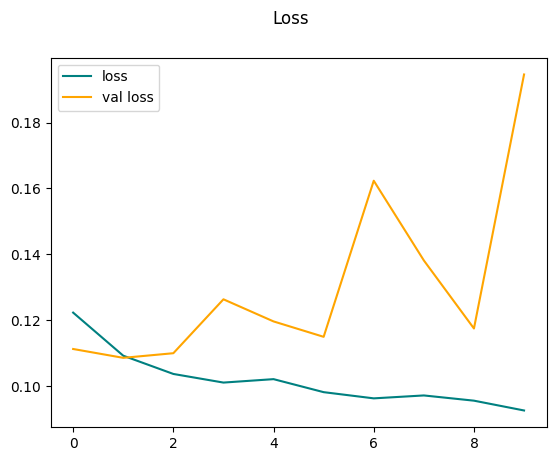

In [67]:
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val loss')
plt.suptitle('Loss')
plt.legend()
plt.show()

In [68]:
%load_ext tensorboard

In [69]:
%tensorboard --logdir './logs'

<IPython.core.display.Javascript object>

# **Inference**

**Make Predictions on Test**

In [70]:
test_data = test.as_numpy_iterator()
test_sample = test_data.next()

In [71]:
print(test_sample[0].shape)

(2, 400, 608, 3)


In [72]:
yhat = model.predict(test_sample[0])

1/1 [==============================] - 0s 84ms/step


/usr/local/lib/python3.10/dist-packages/tensorflow/python/data/ops/structured_function.py:254: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


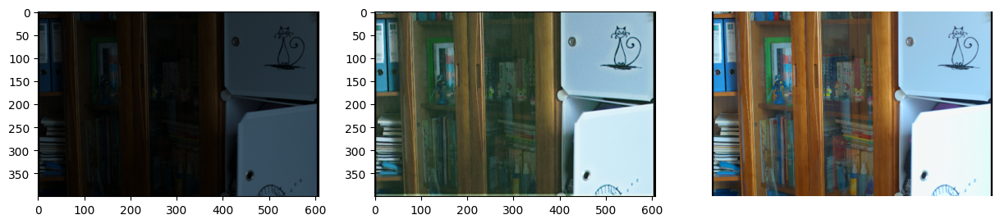

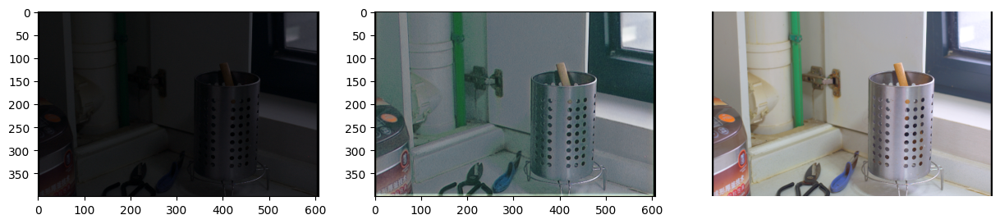

In [73]:
low_1 = test_sample[0][0]
low_2 = test_sample[0][1]

pred_1 = yhat[0]
pred_2 = yhat[1]

high_1 = test_sample[1][0]
high_2 = test_sample[1][1]

fig, ax = plt.subplots(ncols=3, figsize=(15,10));
ax[0].imshow(low_1);
ax[1].imshow(pred_1);
ax[2].imshow(high_1);
plt.axis('off');

fig, ax = plt.subplots(ncols=3, figsize=(15,10));
ax[0].imshow(low_2);
ax[1].imshow(pred_2);
ax[2].imshow(high_2);
plt.axis('off');

**For one Image**

In [74]:
test_lowimg_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/1.png'
test_highimg_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high/1.png'

In [75]:
LowImg = preprocess_image(test_lowimg_path)
HighImg = preprocess_image(test_highimg_path)

In [76]:
test_prediction = model.predict(np.expand_dims(LowImg,axis=0))

1/1 [==============================] - 0s 88ms/step


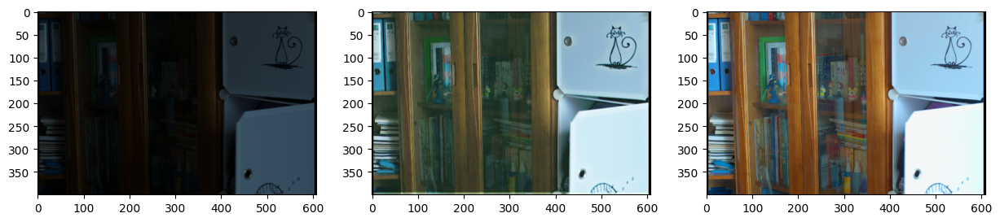

In [77]:
fig, ax = plt.subplots(ncols=3, figsize=(15,10));
ax[0].imshow(LowImg);
ax[1].imshow(test_prediction[0]);
ax[2].imshow(HighImg);

**For All Images in a Folder**

In [78]:
test_low_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low'
test_high_path = r'/content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/high'

In [79]:
def find_target_img_path(test_img_file):
  test_img_filename = os.path.basename(test_img_file)
  high_img_path = os.path.join(test_high_path,test_img_filename)
  return high_img_path

Can save model outputs to a seperate folder

In [80]:
# saving
SAVE_PREDICTIONS = False
if SAVE_PREDICTIONS:
  save_folder_name = 'LLE_UNET_Results'
  save_folder_path = os.path.join(HOME,save_folder_name)
  if not os.path.exists(save_folder_path):
    print("DIRECTORY CREATED")
    os.makedirs(save_folder_path)

1/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/748.png


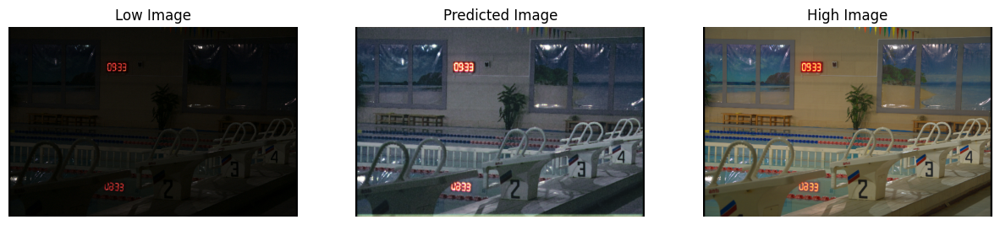

2/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/665.png


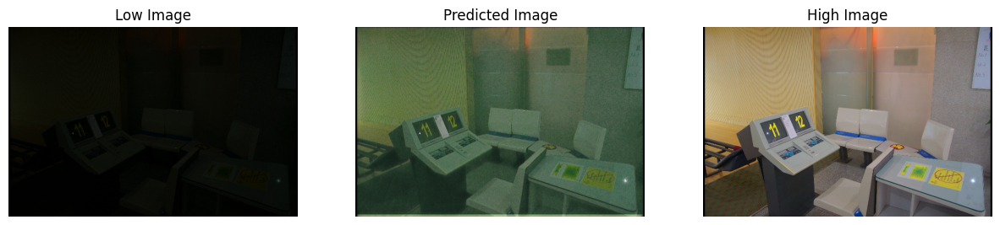

3/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/22.png


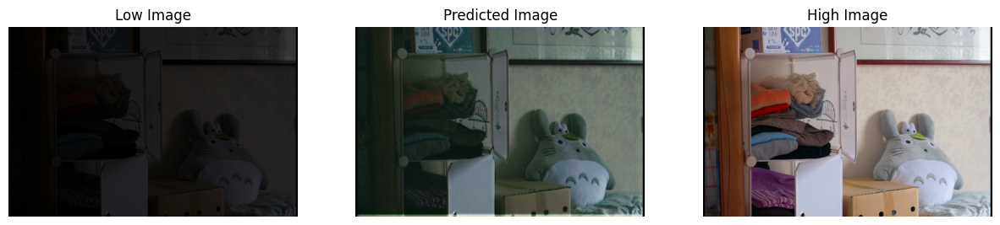

4/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/111.png


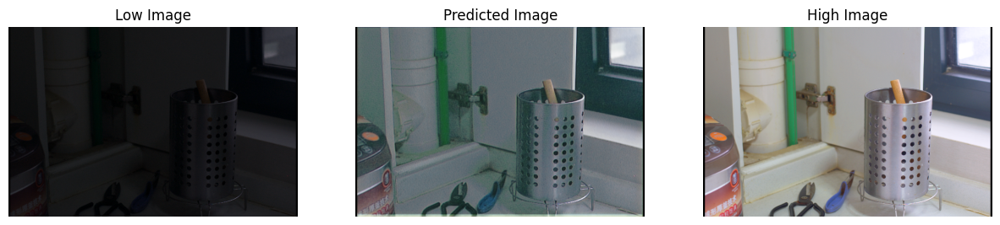

5/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/493.png


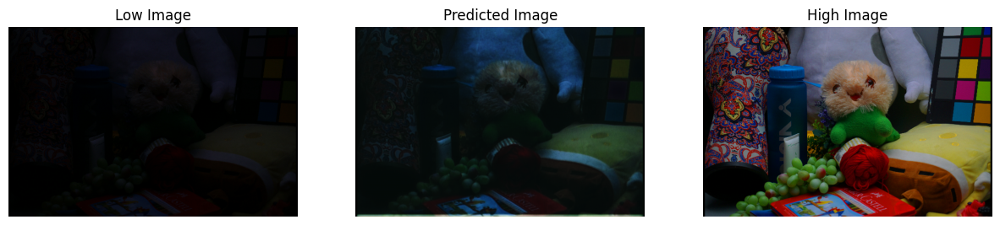

6/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/23.png


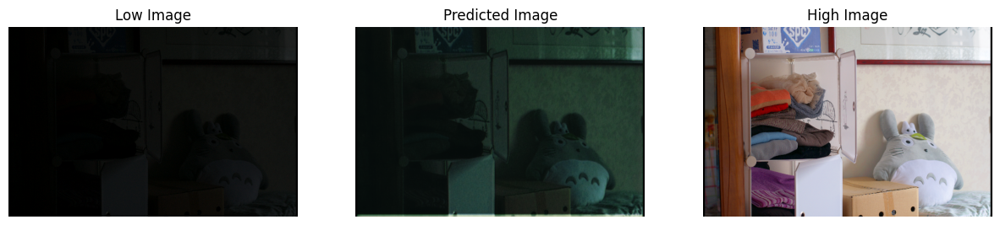

7/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/669.png


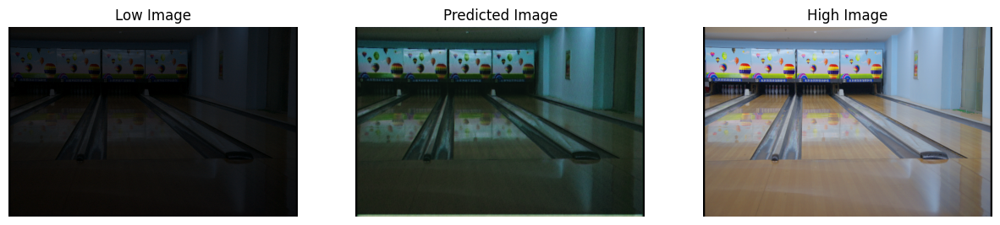

8/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/547.png


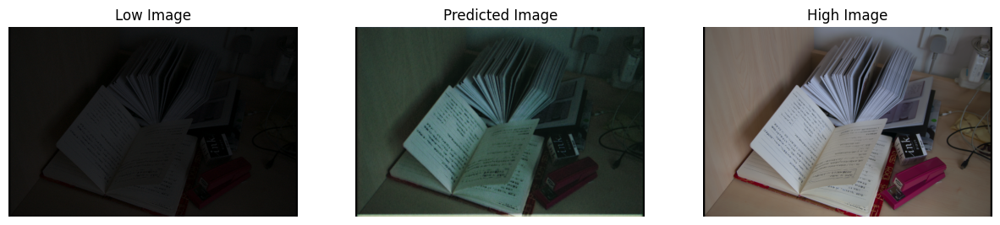

9/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/778.png


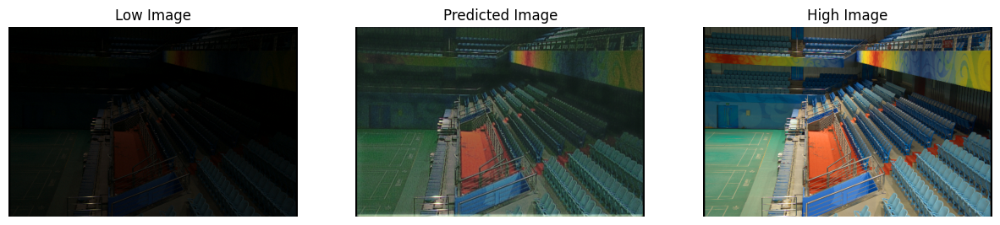

10/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/55.png


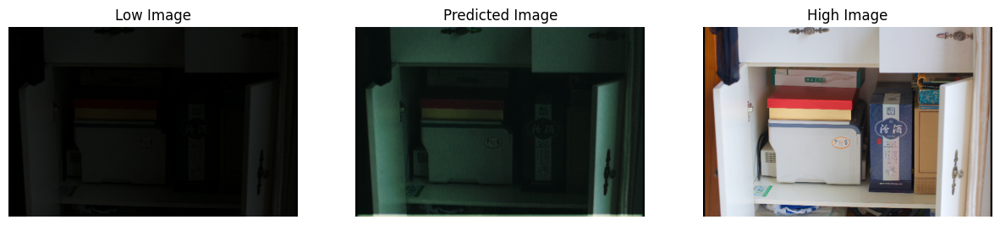

11/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/179.png


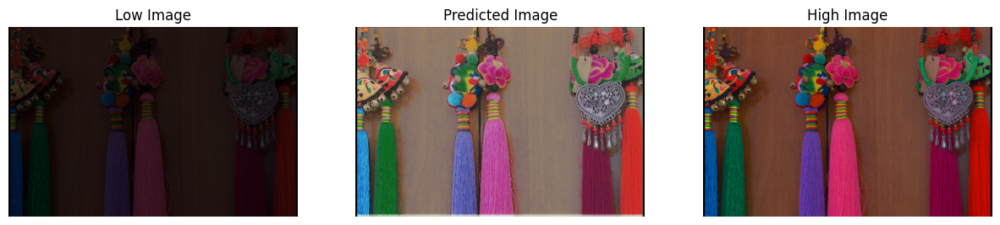

12/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/780.png


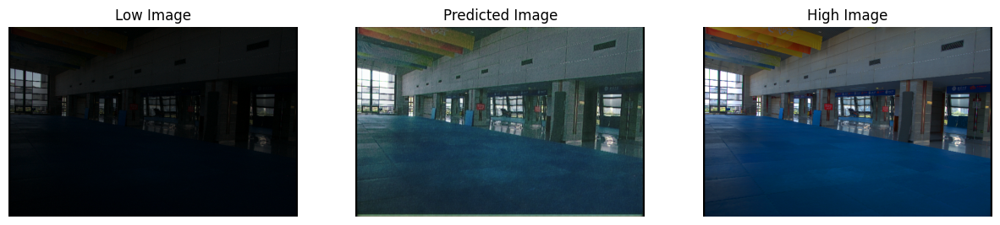

13/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/79.png


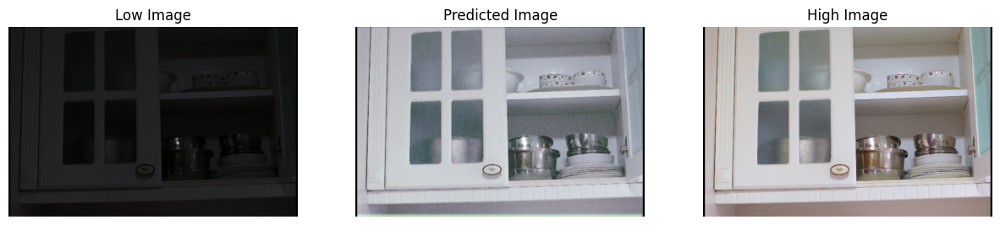

14/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/146.png


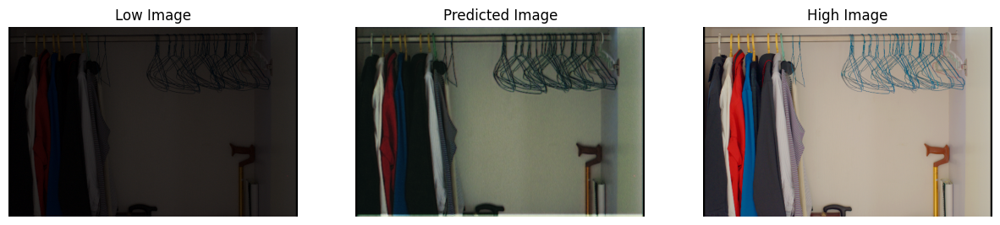

15/15 : /content/drive/MyDrive/FYP/Datastets/Lol_Dataset/LOLdataset_All/eval15/low/1.png


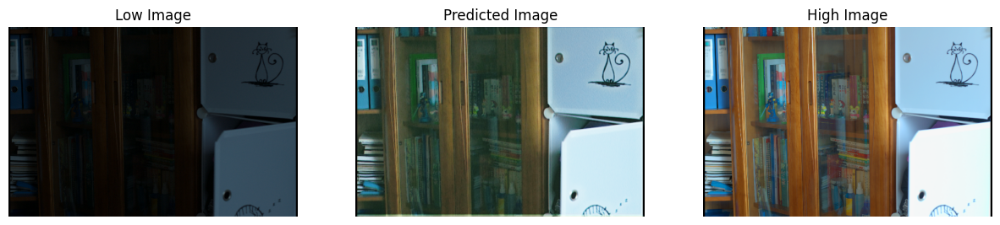

In [85]:
test_low_images = os.listdir(test_low_path)

#n_images = 2
n_images = len(test_low_images)

for i,image_name in enumerate(test_low_images):
  if i==n_images:
    break
  image_path = os.path.join(test_low_path,image_name)
  print(f'{i+1}/{n_images} : {image_path}')
  low_img = preprocess_image(image_path)
  prediction = model.predict(np.expand_dims(low_img,axis=0),verbose=0)

  high_img_path = find_target_img_path(image_path)
  high_img = preprocess_image(high_img_path)

  # Load in CV2 and show in PIL
  # CONVERT BGR to RGB  --> preprocess
  low_img = (low_img*255).astype(np.uint8)
  high_img = (high_img*255).astype(np.uint8)
  predicted_img = (prediction[0]*255).astype(np.uint8)


  fig, ax = plt.subplots(ncols=3, figsize=(15,10));
  ax[0].imshow(low_img);
  ax[1].imshow(predicted_img);
  ax[2].imshow(high_img);
  ax[0].axis('off');
  ax[1].axis('off');
  ax[2].axis('off');
  ax[0].set_title("Low Image")
  ax[1].set_title("Predicted Image")
  ax[2].set_title("High Image")
  plt.show()

  ### save
  if SAVE_PREDICTIONS:
    save_name = f'VGG_{image_name.split(".")[0]}.png'
    save_path = os.path.join(save_folder_path,save_name)
    fig.savefig(save_path,bbox_inches='tight',dpi=300);